# Draft analysis 

---

Group name: Gruppe B Raghid Allaham & Niels-Janos Simmet

---


## Introduction

Over the last couple of years American Football gained a lot of popularity in Europe especially Germany. Different than soccer, American football is a play based game. After each play the game gets interupted for the offense and defense to set up their team once again. The goal is to achieve a touchdown on the opponents endzone. To achieve that the offense works its way across the field play by play. With each play the offense tries to gain as many yards as possible while the defense tries to prevent this. There are 2 main kind of plays to gain yards: rushing and passing. For a rush plays the offensive team tries to gain yards by caring the ball. For pass plays the quarterback of the offensive team will throw to ball to another player. The key difference is the that for rushing plays the ball will not be airborn but handed over. 

*We want to find out if there is a way to predict how many yards a team will gain based on variables that we know before the play starts.*

Other people have already researched similiar questions but i.e. focused on predicting the rushing yards. We focus on yards generally gained no matter if rushed or passed, as this can not be determined before the play starts. Interesting links to check out for similiar analysis:

http://cs229.stanford.edu/proj2019aut/data/assignment_308832_raw/26588266.pdf

https://rpubs.com/woutcault/Final606_Multiple_Regression

https://medium.com/@matthewdmeans/predicting-yards-gained-in-the-nfl-3a0eea7a54a3

### Data Description

For NFL matches there is a comprehensive data asset available that includes play-by-play data, we will focus on the data gathered so far (until 6th December 2022) in the 2022 NFL season. It tracks a multitude of variables for each play. For our analysis we will focus on the variables that are know before the play starts as explanatory variables and the yards gained as the response variable.
The data was scraped from the NFL Next Gen Stats website with the NFL verse package.

Data Source https://github.com/nflverse/nflverse-data/releases/tag/pbp

Data Description https://mrcaseb.github.io/pages_dummy/reference/fast_scraper.html

Our response variable will be "yards-gained" this variable describes how many yards a team gained (or lost) in a play excluding yards gained via fumble recoveries and laterals.

#### Our possible explanatory variables are:


"quarter_seconds_remaining" - Seconds on the clock until the quarter ends

"qtr" - Current quater 1-4 and 5 for overtime

"down" - Current down

"yardline_100" - Distance to the opponents endzone in yards

"ydstogo" - Yards to the next first down

"score_differential" - Score difference between offense team and the defense team

#### Data Dictionary

In [80]:
#Import libraries
import pandas as pd

#Create Data Frame
data_dictionary_content = {
    "Name":[
        "yards_gained",
        "quarter_seconds_remaining",
        "qtr",
        "down",
        "yardline_100",
        "ydstogo",
        "score_differential",
        "(posteam)",
        "(defteam)",
        "(home_team)",
        "(away_team)",
        "(weather)"

    ],

    "Description":[
        "Yards gained/lost in the play excluding yards gained via fumble recoveries and laterals",
        "Seconds on the clock until the quarter ends",
        "Current quater 1-4 and 5 for overtime",
        "Current down",
        "Distance to the opponents endzone in yards",
        "Yards to the next first down",
        "Score difference between offense team and the defense team",
        "Offense Team (We have not yet decided if we want to differentiate by teams)",
        "Defense Team (We have not yet decided if we want to differentiate by teams)",
        "Home Team (We have not yet decided if we want to differentiate by teams)",
        "Guest/Away Team (We have not yet decided if we want to differentiate by teams)",
        "Weather conditions (We are not yet sure if we want to include this variable)"
    ],

    "Role":[
        "Response",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor",
        "Predictor"
    ],

    "Type":[
        "numeric",
        "numeric",
        "numeric",
        "numeric",
        "numeric",
        "numeric",
        "numeric",
        "nominal",
        "nominal",
        "nominal",
        "nominal",
        "includes nominal and numeric"        
    ],

    "Format":[
        "float64",
        "int64",
        "int64",
        "float64",
        "float64",
        "int64",
        "float64",
        "object",
        "object",
        "object",
        "object",
        "object"
    ]
}

data_dictionary = pd.DataFrame(data_dictionary_content)

data_dictionary

,Name,Description,Role,Type,Format
0,yards_gained,Yards gained/lost in the play excluding yards ...,Response,numeric,float64
1,quarter_seconds_remaining,Seconds on the clock until the quarter ends,Predictor,numeric,int64
2,qtr,Current quater 1-4 and 5 for overtime,Predictor,numeric,int64
3,down,Current down,Predictor,numeric,float64
4,yardline_100,Distance to the opponents endzone in yards,Predictor,numeric,float64
5,ydstogo,Yards to the next first down,Predictor,numeric,int64
6,score_differential,Score difference between offense team and the ...,Predictor,numeric,float64
7,(posteam),Offense Team (We have not yet decided if we wa...,Predictor,nominal,object
8,(defteam),Defense Team (We have not yet decided if we wa...,Predictor,nominal,object
9,(home_team),Home Team (We have not yet decided if we want ...,Predictor,nominal,object


## Setup

In [81]:
#Import libraries
import pandas as pd
import altair as alt
import time
import datetime
import pickle
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
import warnings

alt.data_transformers.disable_max_rows()
warnings.simplefilter(action='ignore', category=FutureWarning)

# Set Pandas to show more rows in the output
pd.set_option('display.max_rows', 500)

## Data

## Import data

In [82]:
# Loading Data
path = "..\\data\\raw\\play_by_play_2022.csv"
df = pd.read_csv(path, low_memory=False)

### Data corrections

In [83]:
# Select the relevant variables
column_selection = [
"yards_gained",
"home_team",
"away_team",
"quarter_seconds_remaining",
"qtr",
"down",
"yardline_100",
"ydstogo",
"posteam",
"defteam",
"score_differential",
"weather"
]

# Filter dataframe for relevant variables
df_small = df[column_selection]

# drop rows with missing values
df_small.dropna(inplace=True)

C:\Users\nsimmet\AppData\Local\Temp\ipykernel_14372\1389556148.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_small.dropna(inplace=True)


### Data structure

In [84]:
df_small.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27219 entries, 2 to 33013
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   yards_gained               27219 non-null  float64
 1   home_team                  27219 non-null  object 
 2   away_team                  27219 non-null  object 
 3   quarter_seconds_remaining  27219 non-null  int64  
 4   qtr                        27219 non-null  int64  
 5   down                       27219 non-null  float64
 6   yardline_100               27219 non-null  float64
 7   ydstogo                    27219 non-null  int64  
 8   posteam                    27219 non-null  object 
 9   defteam                    27219 non-null  object 
 10  score_differential         27219 non-null  float64
 11  weather                    27219 non-null  object 
dtypes: float64(4), int64(3), object(5)
memory usage: 2.7+ MB


### Variable lists

In [85]:
# define outcome variable as y_label
y_label = 'yards_gained'

# select features
X = df_small

# create response
y = df_small[y_label]

### Data splitting

In [86]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 1)

## Analysis

### Descriptive statistics

In [87]:
# Summary statistics
print(df_small.mean())

df_small.describe().T

yards_gained                   4.678239
quarter_seconds_remaining    424.736434
qtr                            2.572284
down                           1.995665
yardline_100                  51.023770
ydstogo                        8.454131
score_differential            -1.441530
dtype: float64


,count,mean,std,min,25%,50%,75%,max
yards_gained,27219.0,4.678239,8.160971,-26.0,0.0,2.0,7.0,98.0
quarter_seconds_remaining,27219.0,424.736434,272.362244,0.0,174.0,414.0,660.0,900.0
qtr,27219.0,2.572284,1.133893,1.0,2.0,3.0,4.0,5.0
down,27219.0,1.995665,1.002303,1.0,1.0,2.0,3.0,4.0
yardline_100,27219.0,51.023770,24.303572,1.0,32.0,55.0,71.0,99.0
ydstogo,27219.0,8.454131,4.100022,1.0,6.0,10.0,10.0,38.0
score_differential,27219.0,-1.441530,9.176805,-37.0,-7.0,0.0,3.0,37.0


### Exploratory data analysis

In [88]:
# Histogram Occurency of Yards gained
df_tmp=df_small

alt.Chart(df_tmp).mark_bar().encode(
    x=alt.X("yards_gained"),
    y=alt.Y('count()'),

).interactive()

alt.Chart(...)

We can see that many plays result in zero yards gained. This is due to plays being aborted i.e. by incomplete passes or fouls.

In [89]:
# Histogram Occurency of Yards gained without plays were no yards were gained/lost
df_tmp=df_small.loc[df.yards_gained != 0]

alt.Chart(df_tmp).mark_bar().encode(
    x=alt.X("yards_gained"),
    y=alt.Y('count()'),
).interactive()

alt.Chart(...)

Filtering out the plays that result in zero yards gained we have a distribution like we would expect.

In [90]:
# Histogram Occurency of Yards gained with logarithmic scale on y-axis
df_tmp=df_small
alt.Chart(df_tmp).mark_bar().encode(
    x=alt.X("yards_gained"),
    y=alt.Y('count()',       
            scale=alt.Scale(type='symlog'))
)

alt.Chart(...)

By making the y-axis logarithmic we can also display the histogram better without filtering out the zero values.

In [91]:
#Propability that a team gains yards with a play

print("Propability that a team gains yards with a play: " + str(round((len(df_small.loc[df_small.yards_gained > 0])  / len(df_small)) * 100, 2) ))

Propability that a team gains yards with a play: 57.93


### Relationships
Now we want to understand the relationship between our given variables.

In [92]:
# Explorative analysis of correlation between the variables

# List of our numeric variables
list_numeric = ["yards_gained",
"quarter_seconds_remaining",
"qtr",
"down",
"yardline_100",
"ydstogo",
"score_differential"
]
alt.Chart(df_small).mark_circle().encode(
    x=alt.X(alt.repeat("column"), 
            type='quantitative',
            scale=alt.Scale(zero=False)
            ),
    y=alt.Y(alt.repeat("row"), 
            type='quantitative',
            scale=alt.Scale(zero=False)
             )
).properties(
    width=150,
    height=150
).repeat(
    row=list_numeric,
    column=list_numeric
)

alt.RepeatChart(...)

#### Correlation Matrix

With a correlation matrix we want to test which of our variables correlate to each other by what amount. For that we chose the Spearman Method over the Pearson and Kendall Method. It does not really on normality of the data as the Pearson method does. And tests for correlation not dependence as the Kendall Method does

In [93]:
# Correlation Matrix: Spearman Method

corr = df_small[list_numeric].corr(method="spearman").round(2)
corr = corr.style.background_gradient(cmap='twilight_shifted',axis=None)
corr

,yards_gained,quarter_seconds_remaining,qtr,down,yardline_100,ydstogo,score_differential
yards_gained,1.000000,0.050000,-0.030000,-0.170000,0.070000,0.060000,-0.030000
quarter_seconds_remaining,0.050000,1.000000,-0.030000,-0.020000,0.110000,0.010000,0.030000
qtr,-0.030000,-0.030000,1.000000,0.010000,-0.040000,0.020000,-0.040000
down,-0.170000,-0.020000,0.010000,1.000000,-0.060000,-0.390000,0.020000
yardline_100,0.070000,0.110000,-0.040000,-0.060000,1.000000,0.220000,0.010000
ydstogo,0.060000,0.010000,0.020000,-0.390000,0.220000,1.000000,-0.020000
score_differential,-0.030000,0.030000,-0.040000,0.020000,0.010000,-0.020000,1.000000


We can see a that most of the variables do not strongly correlate with each other.

*ydstogo* and *down* are quite strongly correlated as expected, because with each down the offensive team should come closer to the yardline it needs to reach.

*ydstogo* and *yardline_100* also have some correlation which can be explained by the underlying rules of the game. The offensive team can not have more yards to go than they have until they enter the defenses endzone, the distance to which is represented by the *yardline_100* variable. Therefor it's always *ydstogo* <= *yardline_100*

*yards_gained* and *down* also seem to have a correlation which can be explained by 
- the offensive team rather punting (kicking the ball to the direction of the defenses endzone which usually allows the defense to become offense) than trying to gain yards on 4th down
- game tactics as the target distance *ydstogo* correlates with *down*. Teams might more often go for plays that result in just making it to the yardline on 3rd or 4th down rather than aiming for big plays that result in many yards gained.

## Modeling

In [94]:
list_explanatory_variables = [
"quarter_seconds_remaining",
"qtr",
"down",
"yardline_100",
"ydstogo",
"score_differential"
]

### Model 1: Linear regression model

In [95]:
# Select a linear regression model
reg = LinearRegression()

X_num = X[list_explanatory_variables]

X_num.head()

,quarter_seconds_remaining,qtr,down,yardline_100,ydstogo,score_differential
2,896,1,1.0,78.0,10,0.0
3,869,1,1.0,59.0,10,0.0
4,865,1,2.0,59.0,10,0.0
5,841,1,3.0,54.0,5,0.0
6,833,1,4.0,64.0,15,0.0


In [96]:
# consider only numerical Variabls 
X_num_train = X_train[list_explanatory_variables]
X_num_test = X_test[list_explanatory_variables]


In [97]:
# Fit the model
X_num = X[list_explanatory_variables]
reg.fit(X_num_train, y_train)

LinearRegression()

In [98]:
# Model intercept
reg.intercept_

5.020155206696028

In [99]:
# Model coefficient
reg.coef_

array([ 5.67294163e-04, -7.68012824e-02, -9.37945238e-01,  2.72649177e-02,
        1.11790930e-02, -2.15529687e-02])

#### Evaluation on Test set

In [100]:
# Prediction for our data
y_pred = reg.predict(X_num_test)

In [132]:
# Mean squared error model 1
model1MSE = mean_squared_error(y_test, y_pred)
model1MSE

63.23305667953913

In [131]:
# Root mean squared error model 1
model1RMSE = mean_squared_error(y_test, y_pred, squared=False)
model1RMSE

7.951921571515852

In [130]:
# Mean absolute error model 1
model1MAE = mean_absolute_error(y_test, y_pred)
model1MAE

5.324286073238683

#### Save Model

Save your model in the folder `models/`. Use a meaningful name and a timestamp.

In [ ]:
ts = time.time()
file = '../models/KN_Model.sav' + datetime.datetime.fromtimestamp(ts).strftime('_%Y-%m-%d-%H_%M_%S') + ".sav"
pickle.dump(reg, open(file, 'wb'))
file

### Model 2: K-Nearest Neighbor Model

In [104]:
reg2 = KNeighborsRegressor(n_neighbors=2)

reg2.fit(X_num_train, y_train)

KNeighborsRegressor(n_neighbors=2)

#### Evaluation on Test set

In [105]:
y_pred2 = reg2.predict(X_num_test)

In [133]:
# Mean squared error model 2
model2MSE = mean_squared_error(y_test, y_pred2)
model2MSE

96.62769409747735

In [134]:
# Root mean squared error model 2
model2RMSE = mean_squared_error(y_test, y_pred2, squared=False)
model2RMSE

9.829938661938707

In [135]:
# Mean absolute error model 2
model2MAE = mean_absolute_error(y_test, y_pred2)
model2MAE

6.491734019103601

#### Save Model

Save your model in the folder `models/`. Use a meaningful name and a timestamp.

In [144]:
ts = time.time()
file = '../models/KN_Model.sav' + datetime.datetime.fromtimestamp(ts).strftime('_%Y-%m-%d-%H_%M_%S') + ".sav"
pickle.dump(reg2, open(file, 'wb'))
file

'../models/KN_Model.sav_2022-12-24-09_47_39.sav'

### Model 3: Lasso Regression

#### Standardization

- Lasso performs best when all numerical features are centered around 0 and have variance in the same order. 
- If a feature has a variance that is orders of magnitude larger than others, it might dominate the objective function and make the estimator unable to learn from other features correctly as expected.
- This means it is important to standardize our features. 

$$z = \frac{(x- \bar x)}{s}$$

In [109]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler().fit(X_num_train) 

X_num_train = scaler.transform(X_num_train)
X_num_test = scaler.transform(X_num_test)

In [110]:
X_num_train

array([[ 0.59534443,  1.26132612, -0.98717107, -0.74407625,  0.37214238,
        -2.13004894],
       [ 0.56955653, -0.50275276,  0.01254034,  0.37237017, -0.3640666 ,
         1.24442534],
       [ 0.21957781, -0.50275276,  0.01254034,  1.24071739, -1.34567858,
         0.15588525],
       ...,
       [ 0.33746538, -0.50275276,  0.01254034, -1.9432224 , -1.10027558,
         1.02671732],
       [-1.51926379, -0.50275276, -0.98717107,  0.86856858,  0.37214238,
        -0.17067678],
       [ 0.21220984,  0.37928668, -0.98717107, -1.8191728 , -0.3640666 ,
         0.15588525]])

In [111]:
from sklearn.linear_model import Lasso
import numpy as np
import matplotlib.pyplot as plt

# numpy.linspace(start, stop, num of samples)
alphas = np.linspace(0.01,500,100)

lasso = Lasso(max_iter=10000)

coefs = []


for a in alphas:
    lasso.set_params(alpha=a)
    lasso.fit(X_num_train, y_train)
    coefs.append(lasso.coef_)

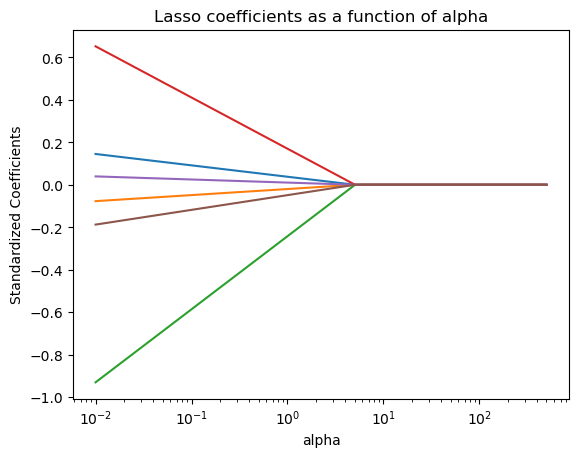

In [112]:
ax = plt.gca()

ax.plot(alphas, coefs)
ax.set_xscale('log')
plt.axis('tight')
plt.xlabel('alpha')
plt.ylabel('Standardized Coefficients')
plt.title('Lasso coefficients as a function of alpha');

#### Lasso with optimal alpha

- To find the optimal value of alpha, we use scikit learns lasso linear model with iterative fitting along a regularization path ([LassoCV](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LassoCV.html)). 

- The best model is selected by cross-validation.

##### k-fold cross validation

In [113]:
from sklearn.linear_model import LassoCV

# Lasso with 5 fold cross-validation
reg = LassoCV(cv=5, random_state=0, max_iter=10000)

# Fit model
reg.fit(X_num_train, y_train)

LassoCV(cv=5, max_iter=10000, random_state=0)

In [114]:
# Show best value of penalization chosen by cross validation:
reg.alpha_

0.0009990293351603535

In [115]:
# Set best alpha
lasso_best = Lasso(alpha=reg.alpha_)

lasso_best.fit(X_num_train, y_train)

Lasso(alpha=0.0009990293351603535)

In [116]:
print(list(zip(lasso_best.coef_, X))) #????

[(0.15309316423708602, 'yards_gained'), (-0.08609025916696059, 'home_team'), (-0.9374846771646945, 'away_team'), (0.6586675507358188, 'quarter_seconds_remaining'), (0.04494016231488308, 'qtr'), (-0.19696988808809696, 'down')]


#### Evaluation on Test set

In [117]:
# Show score

print('R squared training set', round(lasso_best.score(X_num_train, y_train)*100, 2))
print('R squared test set', round(lasso_best.score(X_num_test, y_test)*100, 2))

R squared training set 2.28
R squared test set 2.21


In [136]:
# Mean squared error model 3
model3MSE = mean_squared_error(y_test, lasso_best.predict(X_num_test))
model3MSE

63.23240192832752

In [137]:
# Root mean squared error model 3
model3RMSE = mean_squared_error(y_test, lasso_best.predict(X_num_test), squared=False)
model3RMSE

7.951880402038722

In [138]:
# Mean absolute error model 3
model3MAE = mean_absolute_error(y_test, lasso_best.predict(X_num_test))
model3MAE

5.324404501686137

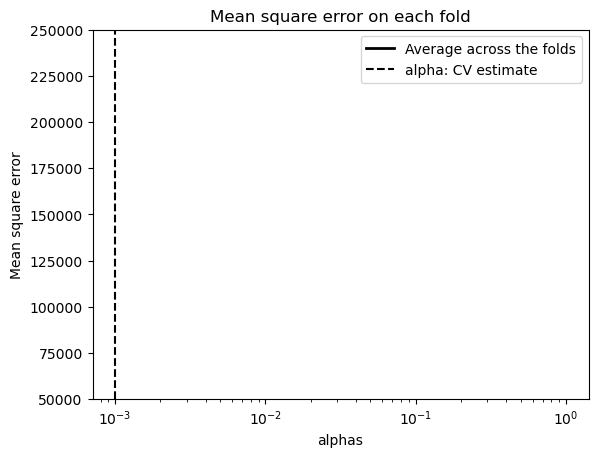

In [121]:
plt.semilogx(reg.alphas_, reg.mse_path_, ":")

plt.plot(
    reg.alphas_ ,
    reg.mse_path_.mean(axis=-1),
    "k",
    label="Average across the folds",
    linewidth=2,
)
plt.axvline(
    reg.alpha_, linestyle="--", color="k", label="alpha: CV estimate"
)

plt.legend()
plt.xlabel("alphas")
plt.ylabel("Mean square error")
plt.title("Mean square error on each fold")
plt.axis("tight")

ymin, ymax = 50000, 250000
plt.ylim(ymin, ymax);

### "Model 4": Always predict the mean value

In [141]:
y_prediction_model4 = np.full(len(y_test),y_train.mean())
y_prediction_model4

array([4.71547788, 4.71547788, 4.71547788, ..., 4.71547788, 4.71547788,
       4.71547788])

In [143]:
# Mean squared error model 4
model4MSE = mean_squared_error(y_test, y_prediction_model4)
model4MSE


64.67880972705233

In [145]:
# Root mean squared error model 4
model4RMSE = mean_squared_error(y_test, y_prediction_model4, squared=False)
model4RMSE

8.04231370483969

In [146]:
# Mean absolute error model 4
model4MAE = mean_absolute_error(y_test, y_prediction_model4)
model4MAE

5.484829548327102

## Conclusions

In this section, the two models "Linear Regression" and "KNeighborsRegressor" were investigated and evaluated.
It was found that linear regression is not suitable for the training data. In contrast, the KNeighborsRegressor model is very well suited for predictions. These statements were made on the basis of the MSE values.

In [149]:
comparison_models_content = {
    "Model":[
        "Linear Regression",
        "K-nearest neighbour",
        "Lasso Regression",
        "Mean Value",
    ],
    "MSE":[
        model1MSE,
        model2MSE,
        model3MSE,
        model4MSE
    ],
    "RMSE":[
        model1RMSE,
        model2RMSE,
        model3RMSE,
        model4RMSE
    ],
    "MAE":[
        model1MAE,
        model2MAE,
        model3MAE,
        model4MAE
    ]
}

comparison_models = pd.DataFrame(comparison_models_content)
comparison_models

,Model,MSE,RMSE,MAE
0,Linear Regression,63.233057,7.951922,5.324286
1,K-nearest neighbour,96.627694,9.829939,6.491734
2,Lasso Regression,63.232402,7.951880,5.324405
3,Mean Value,64.678810,8.042314,5.484830


In [123]:
# Bin mir nicht sicher aber glaub hier haben wir einen Logikfehler. Hab das ganze nochmal gemacht unter "Model 4"


my_df = pd.DataFrame({'pred':y_pred2,  'y':y_test})
my_df.iloc[0:100]

df2 = sum(abs(my_df["pred"] - y_test.mean()))/len(my_df["pred"])
print(df2)
my_df

4.13702441123576


,pred,y
25463,6.5,0.0
32784,2.0,1.0
11321,1.5,0.0
5007,2.0,2.0
10638,0.0,0.0
...,...,...
2833,34.5,0.0
29234,1.5,-1.0
1631,4.0,7.0
7379,18.0,4.0
